In [1]:
using Pkg
Pkg.add("Plots")

   Resolving package versions...
    Updating `/pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/Project.toml`
  [91a5bcdd] + Plots v1.40.8
    Updating `/pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/Manifest.toml`
  [d1d4a3ce] + BitFlags v0.1.9
  [944b1d66] + CodecZlib v0.7.6
  [f0e56b4a] + ConcurrentUtilities v2.4.2
  [d38c429a] + Contour v0.6.3
  [8bb1440f] + DelimitedFiles v1.9.1
  [460bff9d] + ExceptionUnwrapping v0.1.10
  [c87230d0] + FFMPEG v0.4.2
  [1fa38f19] + Format v1.3.7
  [28b8d3ca] + GR v0.73.8
  [42e2da0e] + Grisu v1.0.2
  [cd3eb016] + HTTP v1.10.9
  [1019f520] + JLFzf v0.1.8
  [b964fa9f] + LaTeXStrings v1.4.0
  [23fbe1c1] + Latexify v0.16.5
  [e6f89c97] + LoggingExtras v1.1.0
  [442fdcdd] + Measures v0.3.2
  [4d8831e6] + OpenSSL v1.4.3
  [b98c9c47] + Pipe v1.3.0
  [ccf2f8ad] + PlotThemes v3.3.0
  [995b91a9] + PlotUtils v1.4.3
  [91a5bcdd] + Plots v1.40.8
  [01d81517] + RecipesPipeline v0.6.12
  [05181044] + RelocatableFolders v1.0.1
  [6c6a2e73] + Sc

In [3]:
import Pkg; Pkg.add("ColorTypes")

   Resolving package versions...
    Updating `/pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/Project.toml`
⌅ [3da002f7] + ColorTypes v0.11.5
  No Changes to `/pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/Manifest.toml`


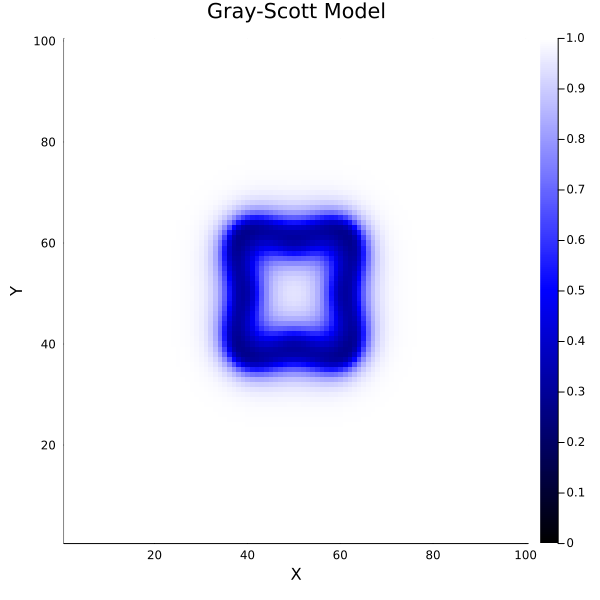

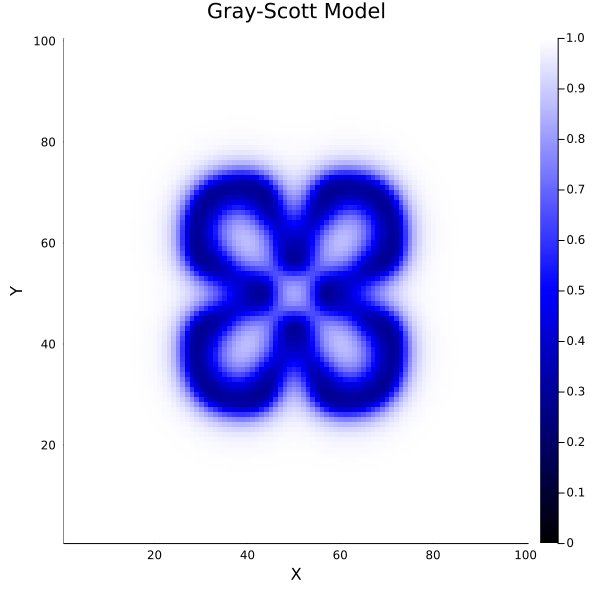

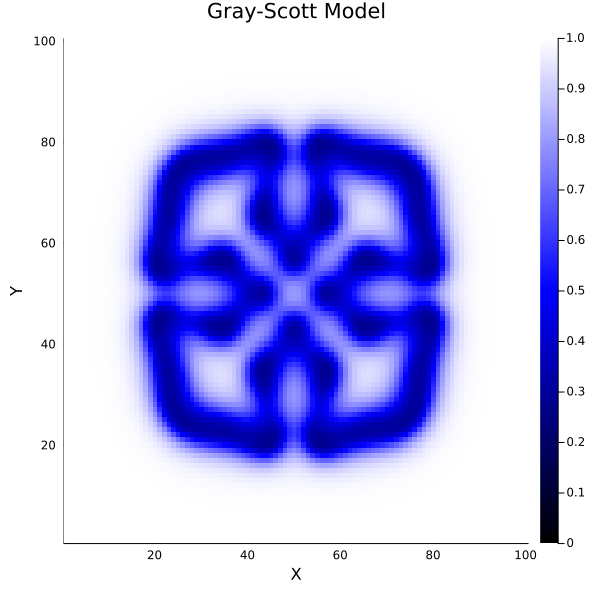

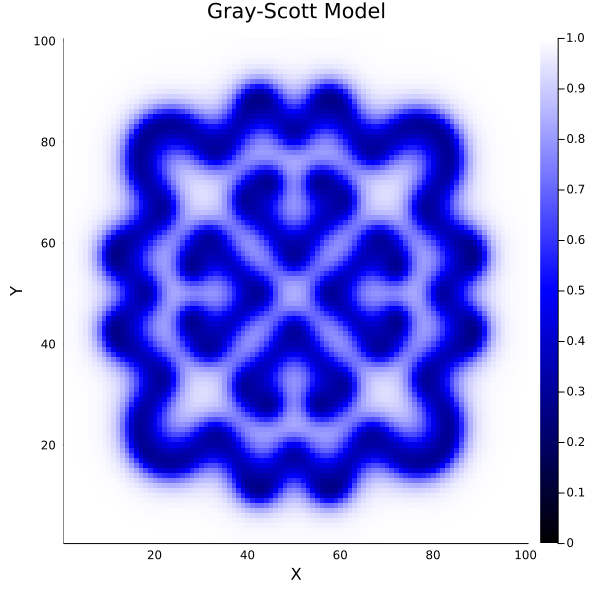

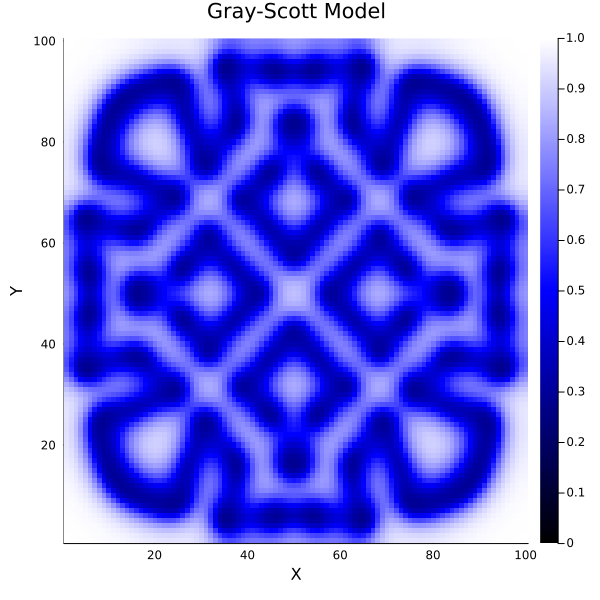

...

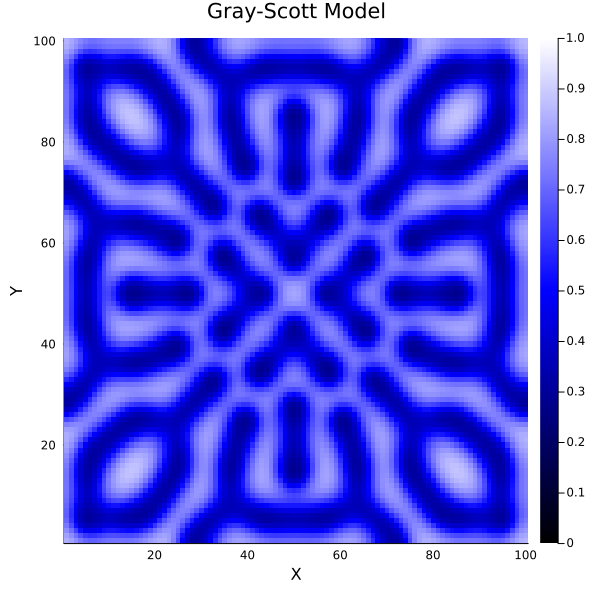

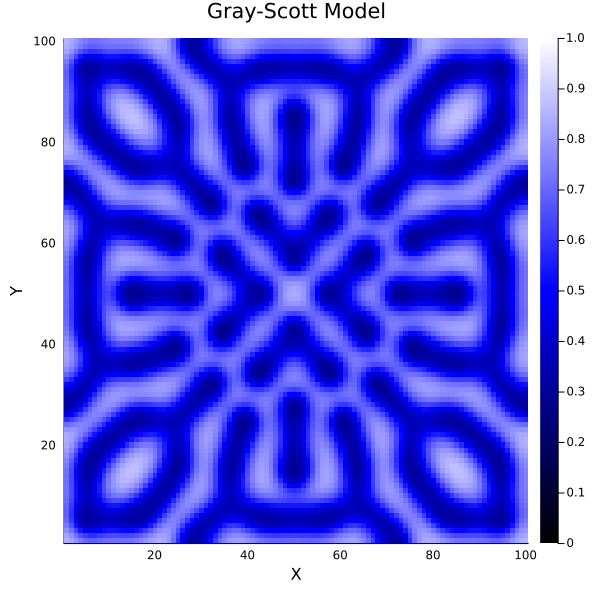

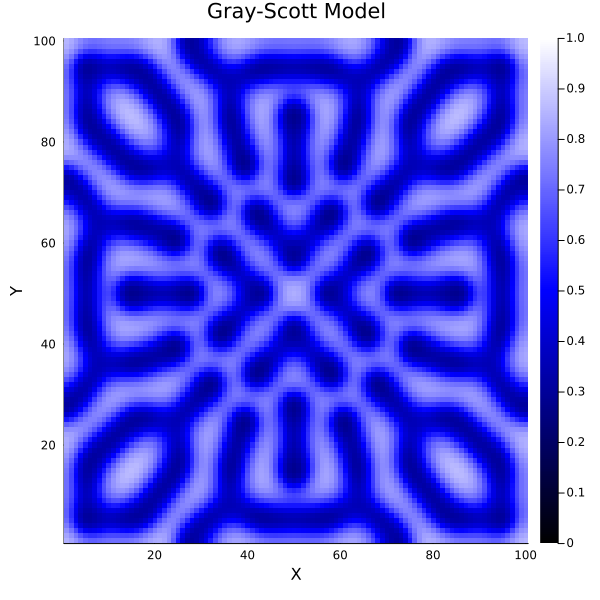

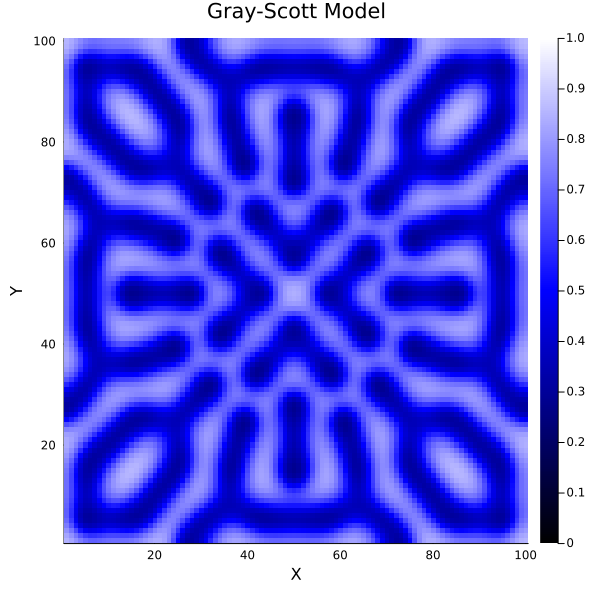

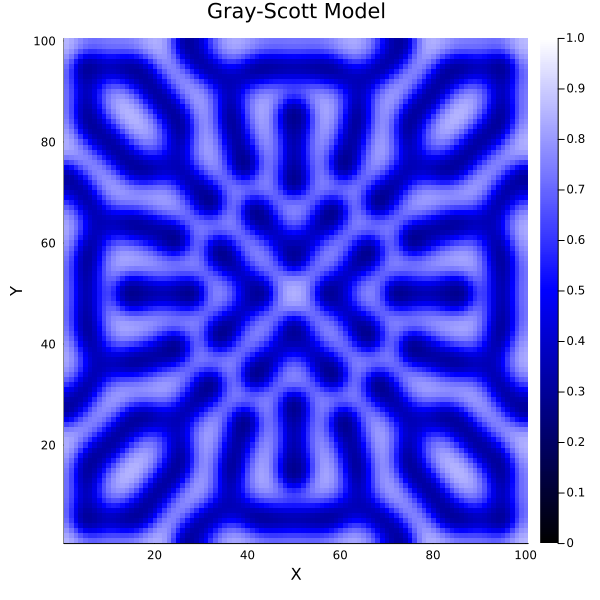

In [2]:
using Plots
using ColorTypes

# Initialize parameters
const D_u = 0.16         # Diffusion rate of U
const D_v = 0.08         # Diffusion rate of V
const F = 0.035          # Feed rate
const k = 0.06           # Kill rate
const dt = 1.0           # Time step
const dx = 1.0           # Spatial step
n = 100                  # Grid size
const steps = 10000      # Number of iterations

# Initialize concentration fields U and V
U = ones(n, n)
V = zeros(n, n)

# Set up an initial small disturbance
U[45:55, 45:55] .= 0.5
V[45:55, 45:55] .= 0.25

# Laplacian function to approximate diffusion
function laplacian(A)
    roll_x = circshift(A, (1, 0)) + circshift(A, (-1, 0))
    roll_y = circshift(A, (0, 1)) + circshift(A, (0, -1))
    roll_xy = -4 * A
    return (roll_x + roll_y + roll_xy) / dx^2
end

# Set up a figure for the heatmaps
p = plot(title="Gray-Scott Model", xlabel="X", ylabel="Y", size=(600, 600))

# Simulation loop
for t in 1:steps
    # Compute diffusion
    ΔU = laplacian(U)
    ΔV = laplacian(V)
    
    # Update concentration fields
    UVV = U .* V .* V
    U += (D_u * ΔU - UVV + F * (1 .- U)) * dt
    V += (D_v * ΔV + UVV - (F + k) * V) * dt

    # Plot every 500 steps
    if t % 500 == 0
        heatmap!(p, U, color=cgrad([:black, :blue, :white]), clims=(0, 1), title="Gray-Scott Model")
        display(p)
    end
end

[ Info: Saved animation to /pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/gs.gif


Plots.AnimatedGif("/pscratch/sd/t/train920/julia-hpc-tutorial-sc24/parts/gpu/gs.gif")
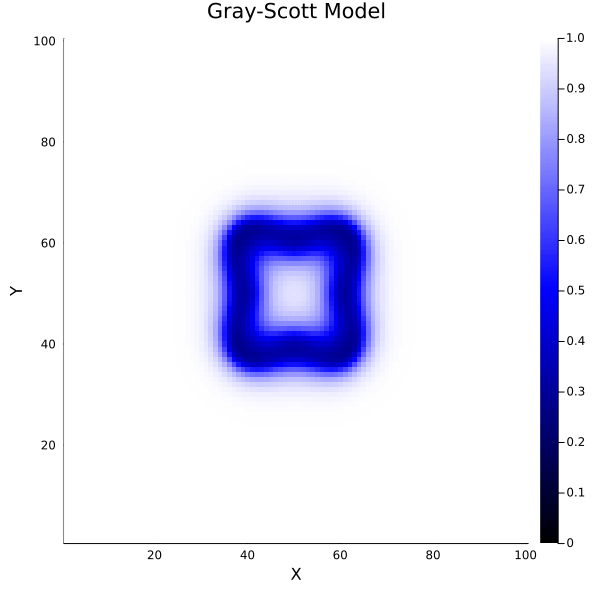

In [3]:
function demo_gs()
    # Initialize parameters
    D_u = 0.16         # Diffusion rate of U
    D_v = 0.08         # Diffusion rate of V
    F = 0.035          # Feed rate
    k = 0.06           # Kill rate
    dt = 1.0           # Time step
    dx = 1.0           # Spatial step
    n = 100            # Grid size
    steps = 10_000     # Number of iterations
    
    # Initialize concentration fields U and V
    U = ones(n, n)
    V = zeros(n, n)

    # Set up an initial small disturbance
    U[45:55, 45:55] .= 0.5
    V[45:55, 45:55] .= 0.25

    # Laplacian function to approximate diffusion
    function laplacian(A)
        roll_x = circshift(A, (1, 0)) + circshift(A, (-1, 0))
        roll_y = circshift(A, (0, 1)) + circshift(A, (0, -1))
        roll_xy = -4 * A
        return (roll_x + roll_y + roll_xy) / dx^2
    end

    # Set up a figure for the heatmaps
    p = Plots.plot(title="Gray-Scott Model", xlabel="X", ylabel="Y", size=(600, 600))

    # Simulation loop
    anim = Plots.@animate for T in 1:div(steps, 500)
        for t in 1:500
            # Compute diffusion
            ΔU = laplacian(U)
            ΔV = laplacian(V)

            # Update concentration fields
            UVV = U .* V .* V
            U .+= (D_u .* ΔU .- UVV .+ F .* (1 .- U)) .* dt
            V .+= (D_v .* ΔV .+ UVV .- (F .+ k) .* V) .* dt
        end

        # Plot every 500 steps
        Plots.heatmap!(p, U, color=cgrad([:black, :blue, :white]), clims=(0, 1), title="Gray-Scott Model")
        p
    end
    gif(anim, "gs.gif"; fps=10)
end
demo_gs()
